In [0]:
# files name and path 
# dbfs:/user/hive/warehouse/online_retail_i_ia
# dbfs:/user/hive/warehouse/online_retail_i_ib
#

# Import Spark modules
from pyspark.sql import SparkSession
from pyspark.sql.functions import col

# Create a SparkSession
spark = SparkSession.builder.appName("Read CSV with Headers").getOrCreate()

# Read the first  CSV file into a DataFrame
dfa = spark.read.option("header", "true").option("inferSchema", "true").load("dbfs:/user/hive/warehouse/online_retail_i_ia")

# Read the second CSV file into a DataFrame
dfb = spark.read.option("header", "true").option("inferSchema", "true").load("dbfs:/user/hive/warehouse/online_retail_i_ib")

# Show the first few rows of the first DataFrame
#dfa.show()

# Show the first few rows of the second  DataFrame
#dfb.show()

# apend dfb to dfa to combined both df into one online_retail_II 
# Use union to append dfb to dfa
online_retail_II_df = dfa.union(dfb)

# Show the result DataFrame
online_retail_II_df.show()


+-------+---------+--------------------+--------+--------------+-----+-----------+--------------+
Invoice|StockCode| Description|Quantity| InvoiceDate|Price|Customer ID| Country|
+-------+---------+--------------------+--------+--------------+-----+-----------+--------------+
 536365| 85123A|WHITE HANGING HEA...| 6|12/1/2010 8:26| 2.55| 17850|United Kingdom|
 536365| 71053| WHITE METAL LANTERN| 6|12/1/2010 8:26| 3.39| 17850|United Kingdom|
 536365| 84406B|CREAM CUPID HEART...| 8|12/1/2010 8:26| 2.75| 17850|United Kingdom|
 536365| 84029G|KNITTED UNION FLA...| 6|12/1/2010 8:26| 3.39| 17850|United Kingdom|
 536365| 84029E|RED WOOLLY HOTTIE...| 6|12/1/2010 8:26| 3.39| 17850|United Kingdom|
 536365| 22752|SET 7 BABUSHKA NE...| 2|12/1/2010 8:26| 7.65| 17850|United Kingdom|
 536365| 21730|GLASS STAR FROSTE...| 6|12/1/2010 8:26| 4.25| 17850|United Kingdom|
 536366| 22633|HAND WARMER UNION...| 6|12/1/2010 8:28| 1.85| 17850|United Kingdom|
 536366| 22632|HAND WARMER RED P...| 6|12/1/2010 8:28| 1.85| 17850|United Kingdom|
 536368| 22960|JAM MAKING SET WI...| 6|12/1/2010 8:34| 4.25| 13047|United Kingdom|
 536368| 22913|RED COAT RACK PAR...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
 536368| 22912|YELLOW COAT RACK ...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
 536368| 22914|BLUE COAT RACK PA...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
 536367| 84879|ASSORTED COLOUR B...| 32|12/1/2010 8:34| 1.69| 13047|United Kingdom|
 536367| 22745|POPPY'S PLAYHOUSE...| 6|12/1/2010 8:34| 2.1| 13047|United Kingdom|
 536367| 22748|POPPY'S PLAYHOUSE...| 6|12/1/2010 8:34| 2.1| 13047|United Kingdom|
 536367| 22749|FELTCRAFT PRINCES...| 8|12/1/2010 8:34| 3.75| 13047|United Kingdom|
 536367| 22310|IVORY KNITTED MUG...| 6|12/1/2010 8:34| 1.65| 13047|United Kingdom|
 536367| 84969|BOX OF 6 ASSORTED...| 6|12/1/2010 8:34| 4.25| 13047|United Kingdom|
 536367| 22623|BOX OF VINTAGE JI...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
+-------+---------+--------------------+--------+--------------+-----+-----------+--------------+
only showing top 20 rows

In [0]:
#correct column name customer it to custID

# Rename the "CustomerID" column to "custID"
online_retail_II_df = online_retail_II_df.withColumnRenamed("Customer ID", "CustID")

# Show the DataFrame with the renamed column
online_retail_II_df.show()

# stats 
# Count the number of rows in the DataFrame
row_count = online_retail_II_df.count()

# show row count
row_count


+-------+---------+--------------------+--------+--------------+-----+------+--------------+
Invoice|StockCode| Description|Quantity| InvoiceDate|Price|CustID| Country|
+-------+---------+--------------------+--------+--------------+-----+------+--------------+
 536365| 85123A|WHITE HANGING HEA...| 6|12/1/2010 8:26| 2.55| 17850|United Kingdom|
 536365| 71053| WHITE METAL LANTERN| 6|12/1/2010 8:26| 3.39| 17850|United Kingdom|
 536365| 84406B|CREAM CUPID HEART...| 8|12/1/2010 8:26| 2.75| 17850|United Kingdom|
 536365| 84029G|KNITTED UNION FLA...| 6|12/1/2010 8:26| 3.39| 17850|United Kingdom|
 536365| 84029E|RED WOOLLY HOTTIE...| 6|12/1/2010 8:26| 3.39| 17850|United Kingdom|
 536365| 22752|SET 7 BABUSHKA NE...| 2|12/1/2010 8:26| 7.65| 17850|United Kingdom|
 536365| 21730|GLASS STAR FROSTE...| 6|12/1/2010 8:26| 4.25| 17850|United Kingdom|
 536366| 22633|HAND WARMER UNION...| 6|12/1/2010 8:28| 1.85| 17850|United Kingdom|
 536366| 22632|HAND WARMER RED P...| 6|12/1/2010 8:28| 1.85| 17850|United Kingdom|
 536368| 22960|JAM MAKING SET WI...| 6|12/1/2010 8:34| 4.25| 13047|United Kingdom|
 536368| 22913|RED COAT RACK PAR...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
 536368| 22912|YELLOW COAT RACK ...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
 536368| 22914|BLUE COAT RACK PA...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
 536367| 84879|ASSORTED COLOUR B...| 32|12/1/2010 8:34| 1.69| 13047|United Kingdom|
 536367| 22745|POPPY'S PLAYHOUSE...| 6|12/1/2010 8:34| 2.1| 13047|United Kingdom|
 536367| 22748|POPPY'S PLAYHOUSE...| 6|12/1/2010 8:34| 2.1| 13047|United Kingdom|
 536367| 22749|FELTCRAFT PRINCES...| 8|12/1/2010 8:34| 3.75| 13047|United Kingdom|
 536367| 22310|IVORY KNITTED MUG...| 6|12/1/2010 8:34| 1.65| 13047|United Kingdom|
 536367| 84969|BOX OF 6 ASSORTED...| 6|12/1/2010 8:34| 4.25| 13047|United Kingdom|
 536367| 22623|BOX OF VINTAGE JI...| 3|12/1/2010 8:34| 4.95| 13047|United Kingdom|
+-------+---------+--------------------+--------+--------------+-----+------+--------------+
only showing top 20 rows

Out[30]: 1609281

In [0]:
# Remove rows with null values in the "CustID" column
online_retail_II_df = online_retail_II_df.dropna(subset=["CustID"])

# Show the DataFrame after removing null values
#online_retail_II_df.show()

# Count AGAIN  the number of rows in the DataFrame
row_count = online_retail_II_df.count()

# show row count AGAIN
row_count


Out[31]: 1231194

In [0]:
# Register the DataFrame as a temporary view to allows the use Spark SQL statements on the DataFrame.
online_retail_II_df.createOrReplaceTempView("online_retail_view")

# Use Spark SQL to add the "total_amount" column to the DataFrame and format it with 2 decimals
online_retail_II_df_total_amount = spark.sql("SELECT *, CAST(FORMAT_NUMBER(Quantity * Price, 2) AS double) AS total_amount FROM online_retail_view")

# Show the DataFrame with the new "total_amount" column and formatted "total_amount_formatted" column
online_retail_II_df_total_amount.show()


+-------+---------+--------------------+--------+--------------+-----+------+--------------+------------+
Invoice|StockCode| Description|Quantity| InvoiceDate|Price|CustID| Country|total_amount|
+-------+---------+--------------------+--------+--------------+-----+------+--------------+------------+
 489434| 85048|15CM CHRISTMAS GL...| 12|12/1/2009 7:45| 6.95| 13085|United Kingdom| 83.4|
 489434| 79323P| PINK CHERRY LIGHTS| 12|12/1/2009 7:45| 6.75| 13085|United Kingdom| 81.0|
 489434| 79323W| WHITE CHERRY LIGHTS| 12|12/1/2009 7:45| 6.75| 13085|United Kingdom| 81.0|
 489434| 22041|RECORD FRAME 7" S...| 48|12/1/2009 7:45| 2.1| 13085|United Kingdom| 100.8|
 489434| 21232|STRAWBERRY CERAMI...| 24|12/1/2009 7:45| 1.25| 13085|United Kingdom| 30.0|
 489434| 22064|PINK DOUGHNUT TRI...| 24|12/1/2009 7:45| 1.65| 13085|United Kingdom| 39.6|
 489434| 21871| SAVE THE PLANET MUG| 24|12/1/2009 7:45| 1.25| 13085|United Kingdom| 30.0|
 489434| 21523|FANCY FONT HOME S...| 10|12/1/2009 7:45| 5.95| 13085|United Kingdom| 59.5|
 489435| 22350| CAT BOWL | 12|12/1/2009 7:46| 2.55| 13085|United Kingdom| 30.6|
 489435| 22349|DOG BOWL , CHASIN...| 12|12/1/2009 7:46| 3.75| 13085|United Kingdom| 45.0|
 489435| 22195|HEART MEASURING S...| 24|12/1/2009 7:46| 1.65| 13085|United Kingdom| 39.6|
 489435| 22353|LUNCHBOX WITH CUT...| 12|12/1/2009 7:46| 2.55| 13085|United Kingdom| 30.6|
 489436| 48173C|DOOR MAT BLACK FL...| 10|12/1/2009 9:06| 5.95| 13078|United Kingdom| 59.5|
 489436| 21755|LOVE BUILDING BLO...| 18|12/1/2009 9:06| 5.45| 13078|United Kingdom| 98.1|
 489436| 21754|HOME BUILDING BLO...| 3|12/1/2009 9:06| 5.95| 13078|United Kingdom| 17.85|
 489436| 84879|ASSORTED COLOUR B...| 16|12/1/2009 9:06| 1.69| 13078|United Kingdom| 27.04|
 489436| 22119| PEACE WOODEN BLO...| 3|12/1/2009 9:06| 6.95| 13078|United Kingdom| 20.85|
 489436| 22142|CHRISTMAS CRAFT W...| 12|12/1/2009 9:06| 1.45| 13078|United Kingdom| 17.4|
 489436| 22296|HEART IVORY TRELL...| 12|12/1/2009 9:06| 1.65| 13078|United Kingdom| 19.8|
 489436| 22295|HEART FILIGREE DO...| 12|12/1/2009 9:06| 1.65| 13078|United Kingdom| 19.8|
+-------+---------+--------------------+--------+--------------+-----+------+--------------+------------+
only showing top 20 rows

In [0]:
# check for null values - Use filter() to select rows where 'total_amount' is null
result_df = online_retail_II_df_total_amount.filter(col("total_amount").isNull())

# Show the selected rows where 'total_amount' is null
result_df.show()

# remove null values 
online_retail_II_df_total_amount = online_retail_II_df_total_amount.filter(col("total_amount").isNotNull())

# see data frame 
online_retail_II_df_total_amount.show()

# Count AGAIN  the number of rows in the DataFrame
row_count = online_retail_II_df_total_amount.count()

# show row count AGAIN
row_count
                                                    

+-------+---------+--------------------+--------+---------------+-----+------+--------------+------------+
Invoice|StockCode| Description|Quantity| InvoiceDate|Price|CustID| Country|total_amount|
+-------+---------+--------------------+--------+---------------+-----+------+--------------+------------+
 489523| 84879|ASSORTED COLOUR B...| 800|12/1/2009 11:46| 1.45| 12931|United Kingdom| null|
 489675| 15056BL|EDWARDIAN PARASOL...| 240| 12/2/2009 9:47| 4.6| 13777|United Kingdom| null|
 489831| 84347|ROTATING SILVER A...| 480|12/2/2009 13:58| 2.1| 12435| Denmark| null|
 489889| 85123A|WHITE HANGING HEA...| 480|12/2/2009 16:52| 2.55| 14646| Netherlands| null|
 490010| 84347|ROTATING SILVER A...| 480|12/3/2009 12:15| 2.1| 15061|United Kingdom| null|
 490018| 21981|PACK OF 12 WOODLA...| 4320|12/3/2009 12:31| 0.25| 17940|United Kingdom| null|
 490018| 21967|PACK OF 12 SKULL ...| 5184|12/3/2009 12:31| 0.25| 17940|United Kingdom| null|
 490018| 21984|PACK OF 12 PINK P...| 4008|12/3/2009 12:31| 0.25| 17940|United Kingdom| null|
 490018| 21980|PACK OF 12 RED SP...| 4008|12/3/2009 12:31| 0.25| 17940|United Kingdom| null|
 490059| 15056BL|EDWARDIAN PARASOL...| 600|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490059| 20679|EDWARDIAN PARASOL...| 600|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490059| 85014B|RED/WHITE DOTS RU...| 576|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490059| 85014A|BLACK/BLUE DOTS R...| 576|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490059| 85014D|PINK/BROWN DOTS R...| 576|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490059| 15059A|ENGLISH ROSE EDWA...| 505|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490059| 15056P|EDWARDIAN PARASOL...| 600|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490059| 15056N|EDWARDIAN PARASOL...| 600|12/3/2009 13:30| 3.0| 18102|United Kingdom| null|
 490061| 84912B| GREEN ROSE WASHBAG| 600|12/3/2009 13:42| 2.0| 18102|United Kingdom| null|
 490061| 84912A| PINK ROSE WASHBAG| 600|12/3/2009 13:42| 2.0| 18102|United Kingdom| null|
 490061| 21000|ROSE DU SUD COSME...| 500|12/3/2009 13:42| 2.0| 18102|United Kingdom| null|
+-------+---------+--------------------+--------+---------------+-----+------+--------------+------------+
only showing top 20 rows

+-------+---------+--------------------+--------+--------------+-----+------+--------------+------------+
Invoice|StockCode| Description|Quantity| InvoiceDate|Price|CustID| Country|total_amount|
+-------+---------+--------------------+--------+--------------+-----+------+--------------+------------+
 489434| 85048|15CM CHRISTMAS GL...| 12|12/1/2009 7:45| 6.95| 13085|United Kingdom| 83.4|
 489434| 79323P| PINK CHERRY LIGHTS| 12|12/1/2009 7:45| 6.75| 13085|United Kingdom| 81.0|
 489434| 79323W| WHITE CHERRY LIGHTS| 12|12/1/2009 7:45| 6.75| 13085|United Kingdom| 81.0|
 489434| 22041|RECORD FRAME 7" S...| 48|12/1/2009 7:45| 2.1| 13085|United Kingdom| 100.8|
 489434| 21232|STRAWBERRY CERAMI...| 24|12/1/2009 7:45| 1.25| 13085|United Kingdom| 30.0|
 489434| 22064|PINK DOUGHNUT TRI...| 24|12/1/2009 7:45| 1.65| 13085|United Kingdom| 39.6|
 489434| 21871| SAVE THE PLANET MUG| 24|12/1/2009 7:45| 1.25| 13085|United Kingdom| 30.0|
 489434| 21523|FANCY FONT HOME S...| 10|12/1/2009 7:45| 5.95| 13085|United Kingdom| 59.5|
 489435| 22350| CAT BOWL | 12|12/1/2009 7:46| 2.55| 13085|United Kingdom| 30.6|
 489435| 22349|DOG BOWL , CHASIN...| 12|12/1/2009 7:46| 3.75| 13085|United Kingdom| 45.0|
 489435| 22195|HEART MEASURING S...| 24|12/1/2009 7:46| 1.65| 13085|United Kingdom| 39.6|
 489435| 22353|LUNCHBOX WITH CUT...| 12|12/1/2009 7:46| 2.55| 13085|United Kingdom| 30.6|
 489436| 48173C|DOOR MAT BLACK FL...| 10|12/1/2009 9:06| 5.95| 13078|United Kingdom| 59.5|
 489436| 21755|LOVE BUILDING BLO...| 18|12/1/2009 9:06| 5.45| 13078|United Kingdom| 98.1|
 489436| 21754|HOME BUILDING BLO...| 3|12/1/2009 9:06| 5.95| 13078|United Kingdom| 17.85|
 489436| 84879|ASSORTED COLOUR B...| 16|12/1/2009 9:06| 1.69| 13078|United Kingdom| 27.04

In [0]:
# sql to select and aggregate the customer data
## note didnt work had to create another temp view??? 
#online_retail_II_df_total_amount9 = spark.sql("SELECT Customer ID, count(distinct stockCode) FROM online_retail_II_df_total_amount")
#online_retail_II_df_total_amount9.show()

# sql to select and aggregate the customer data

# Register the DataFrame as a temporary view AGAIN 
online_retail_II_df_total_amount.createOrReplaceTempView("online_retail_total_amount_view")

# Use Spark SQL to select the required customer ordering patterns 
# note use """""" to incapulate the sql string or single "" for each 
customer_summary = spark.sql("""
    SELECT 
        CustID,
        COUNT(DISTINCT Invoice) AS Unique_Invoice_Orders, 
        COUNT(DISTINCT StockCode) AS Unique_Stockcodes,        
        COUNT(StockCode) AS Total_Stockcode_Orders,
        ROUND(AVG(Price), 2) AS Average_Price_Per_Stockcode,
        ROUND(COUNT(StockCode)/COUNT(DISTINCT Invoice), 0) AS Average_Item_per_order,
        ROUND(SUM(total_amount), 2) AS Total_Amount_Ordered,
        ROUND(SUM(total_amount)/COUNT(DISTINCT Invoice), 2) AS Average_order_Amount        
    FROM online_retail_total_amount_view
    GROUP BY CustID
    HAVING SUM(total_amount) > 0  -- Filter out customers with total amount ordered <= 0
    ORDER BY CustID
""")


# Show the DataFrame with the selected customer ordeing stats and patterns 
customer_summary.show()

# check how many customers 
customer_summary.count()

+------+---------------------+-----------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
CustID|Unique_Invoice_Orders|Unique_Stockcodes|Total_Stockcode_Orders|Average_Price_Per_Stockcode|Average_Item_per_order|Total_Amount_Ordered|Average_order_Amount|
+------+---------------------+-----------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
 12347| 8| 126| 435| 2.59| 54.0| 9943.32| 1242.91|
 12348| 5| 25| 82| 4.53| 16.0| 3816.64| 763.33|
 12349| 5| 139| 253| 8.34| 51.0| 6162.09| 1232.42|
 12350| 1| 17| 34| 3.84| 34.0| 668.8| 668.8|
 12351| 1| 21| 21| 2.36| 21.0| 300.93| 300.93|
 12352| 13| 70| 208| 21.52| 16.0| 3434.62| 264.2|
 12353| 2| 23| 28| 3.12| 14.0| 495.76| 247.88|
 12354| 1| 58| 116| 4.5| 116.0| 2158.8| 2158.8|
 12355| 2| 35| 48| 3.38| 24.0| 1407.01| 703.5|
 12356| 6| 104| 202| 3.16| 34.0| 9185.11| 1530.85|
 12357| 3| 261| 427| 5.32| 142.0| 24495.33| 8165.11|
 12358| 5| 56| 96| 5.94| 19.0| 5055.13| 1011.03|
 12359| 14| 305| 629| 7.97| 45.0| 14960.42| 1068.6|
 12360| 9| 160| 347| 3.44| 39.0| 6874.95| 763.88|
 12361| 4| 18| 39| 3.73| 10.0| 701.15| 175.29|
 12362| 14| 201| 549| 4.18| 39.0| 10439.16| 745.65|
 12363| 2| 23| 46| 2.31| 23.0| 1104.0| 552.0|
 12364| 4| 70| 170| 1.91| 43.0| 2626.2| 656.55|
 12365| 3| 22| 46| 30.35| 15.0| 641.38| 213.79|
 12366| 1| 3| 3| 1.69| 3.0| 500.24| 500.24|
+------+---------------------+-----------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
only showing top 20 rows

Out[34]: 5839

In [0]:
# Show the schema and first few rows of the Spark DataFrame
customer_summary.printSchema()
customer_summary.show()

root
-- CustID: long (nullable = true)
-- Unique_Invoice_Orders: long (nullable = false)
-- Unique_Stockcodes: long (nullable = false)
-- Total_Stockcode_Orders: long (nullable = false)
-- Average_Price_Per_Stockcode: double (nullable = true)
-- Average_Item_per_order: double (nullable = true)
-- Total_Amount_Ordered: double (nullable = true)
-- Average_order_Amount: double (nullable = true)

+------+---------------------+-----------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
CustID|Unique_Invoice_Orders|Unique_Stockcodes|Total_Stockcode_Orders|Average_Price_Per_Stockcode|Average_Item_per_order|Total_Amount_Ordered|Average_order_Amount|
+------+---------------------+-----------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
 12347| 8| 126| 435| 2.59| 54.0| 9943.32| 1242.91|
 12348| 5| 25| 82| 4.53| 16.0| 3816.64| 763.33|
 12349| 5| 139| 253| 8.34| 51.0| 6162.09| 1232.42|
 12350| 1| 17| 34| 3.84| 34.0| 668.8| 668.8|
 12351| 1| 21| 21| 2.36| 21.0| 300.93| 300.93|
 12352| 13| 70| 208| 21.52| 16.0| 3434.62| 264.2|
 12353| 2| 23| 28| 3.12| 14.0| 495.76| 247.88|
 12354| 1| 58| 116| 4.5| 116.0| 2158.8| 2158.8|
 12355| 2| 35| 48| 3.38| 24.0| 1407.01| 703.5|
 12356| 6| 104| 202| 3.16| 34.0| 9185.11| 1530.85|
 12357| 3| 261| 427| 5.32| 142.0| 24495.33| 8165.11|
 12358| 5| 56| 96| 5.94| 19.0| 5055.13| 1011.03|
 12359| 14| 305| 629| 7.97| 45.0| 14960.42| 1068.6|
 12360| 9| 160| 347| 3.44| 39.0| 6874.95| 763.88|
 12361| 4| 18| 39| 3.73| 10.0| 701.15| 175.29|
 12362| 14| 201| 549| 4.18| 39.0| 10439.16| 745.65|
 12363| 2| 23| 46| 2.31| 23.0| 1104.0| 552.0|
 12364| 4| 70| 170| 1.91| 43.0| 2626.2| 656.55|
 12365| 3| 22| 46| 30.35| 15.0| 641.38| 213.79|
 12366| 1| 3| 3| 1.69| 3.0| 500.24| 500.24|
+------+---------------------+-----------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
only showing top 20 rows

In [0]:
# Get the statistical summary using 
summary_df = customer_summary.describe()

# Show the result
summary_df.show()

+-------+------------------+---------------------+------------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
summary| CustID|Unique_Invoice_Orders| Unique_Stockcodes|Total_Stockcode_Orders|Average_Price_Per_Stockcode|Average_Item_per_order|Total_Amount_Ordered|Average_order_Amount|
+-------+------------------+---------------------+------------------+----------------------+---------------------------+----------------------+--------------------+--------------------+
 count| 5839| 5839| 5839| 5839| 5839| 5839| 5839| 5839|
 mean|15316.443397842097| 7.616715190957356| 82.65661928412399| 210.51464291830794| 3.7661191984928917| 29.750128446651825| 4050.1697842096282| 453.61788148655575|
 stddev|1715.6828102795314| 15.952418375842557|116.93825618293909| 559.7173423611671| 6.998120080616901| 29.179402898484817| 17232.077254894193| 484.4143353694126|
 min| 12347| 1| 1| 1| 0.15| 1.0| 0.0| 0.0|
 max| 18287| 506| 2557| 21080| 242.99| 342.0| 768047.17| 10227.72|
+-------+------------------+---------------------+------------------+----------------------+---------------------------+----------------------+--------------------+--------------------+

### KMeans ###

#### Vectorization and Standardization ####

In [0]:
customer_summary.columns

Out[37]: ['CustID',
 'Unique_Invoice_Orders',
 'Unique_Stockcodes',
 'Total_Stockcode_Orders',
 'Average_Price_Per_Stockcode',
 'Average_Item_per_order',
 'Total_Amount_Ordered',
 'Average_order_Amount']

In [0]:
# Import necessary libraries
from pyspark.ml.feature import VectorAssembler, StandardScaler

# Select the numerical columns for normalization
numerical_cols = ['Unique_Invoice_Orders',
 'Unique_Stockcodes',
 'Total_Stockcode_Orders',
 'Average_Price_Per_Stockcode',
 'Average_Item_per_order',
 'Total_Amount_Ordered',
 'Average_order_Amount']

# Assemble the numerical columns into a single vector column
assembler = VectorAssembler(inputCols=numerical_cols, outputCol="features")
assembled_data = assembler.transform(customer_summary)

# Initialize the StandardScaler
scaler = StandardScaler(inputCol="features", outputCol="scaled_features")

# Fit and transform the data using the scaler
scaler_model = scaler.fit(assembled_data)
scaled_data1 = scaler_model.transform(assembled_data)

# Select the 'cust id' column and the normalized numerical columns
normalized_df = scaled_data1.select("CustID", "scaled_features")

# Show the normalized DataFrame
display(normalized_df)


CustID,scaled_features
12347,"Map(vectorType -> dense, length -> 7, values -> List(0.5014913608406076, 1.077491696155317, 0.7771779916001048, 0.37009939386059876, 1.8506204595024125, 0.5770238754689853, 2.5657993772049714))"
12348,"Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 0.21378803495145177, 0.14650251795680136, 0.6473167004588851, 0.5483319880007148, 0.22148461520598228, 1.5757791301074662))"
12349,"Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 1.1886614743300719, 0.4520138663789115, 1.191748627334901, 1.7478082117522784, 0.3575941489149177, 2.5441443615828585))"
12350,"Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.1453758637669872, 0.06074494646989325, 0.5487187924419689, 1.165205474501519, 0.03881133946344453, 1.3806362676900858))"
12351,"Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.17958194935921948, 0.0375189375255223, 0.33723342452162663, 0.7196857342509382, 0.017463361819279852, 0.6212243900059473))"
12352,"Map(vectorType -> dense, length -> 7, values -> List(0.8149234613659874, 0.598606497864065, 0.3716161431099352, 3.075111565976867, 0.5483319880007148, 0.1993154945393778, 0.545400870101257))"
12353,"Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.1966849921553356, 0.05002525003402973, 0.4458340188590997, 0.47979048950062547, 0.02876960175298634, 0.5117107028035563))"
12354,"Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.49598824108736805, 0.20724746442669462, 0.6430298348929322, 3.9754069130051826, 0.12527798988290084, 4.4565155123943745))"
12355,"Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.2993032489320325, 0.08575757148690812, 0.4829868537640246, 0.8224979820010723, 0.08165063208501959, 1.4522691601674274))"
12356,"Map(vectorType -> dense, length -> 7, values -> List(0.3761185206304557, 0.8893582253980393, 0.36089644667407167, 0.45154983961370354, 1.165205474501519, 0.5330239566672833, 3.160207880372859))"


In [0]:
# Select the 'cust id' column and the normalized numerical columns
normalized_df = scaled_data1.select("CustID", "scaled_features")

# Show the normalized DataFrame
display(normalized_df)

CustID,scaled_features
12347,"Map(vectorType -> dense, length -> 7, values -> List(0.5014913608406076, 1.077491696155317, 0.7771779916001048, 0.37009939386059876, 1.8506204595024125, 0.5770238754689853, 2.5657993772049714))"
12348,"Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 0.21378803495145177, 0.14650251795680136, 0.6473167004588851, 0.5483319880007148, 0.22148461520598228, 1.5757791301074662))"
12349,"Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 1.1886614743300719, 0.4520138663789115, 1.191748627334901, 1.7478082117522784, 0.3575941489149177, 2.5441443615828585))"
12350,"Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.1453758637669872, 0.06074494646989325, 0.5487187924419689, 1.165205474501519, 0.03881133946344453, 1.3806362676900858))"
12351,"Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.17958194935921948, 0.0375189375255223, 0.33723342452162663, 0.7196857342509382, 0.017463361819279852, 0.6212243900059473))"
12352,"Map(vectorType -> dense, length -> 7, values -> List(0.8149234613659874, 0.598606497864065, 0.3716161431099352, 3.075111565976867, 0.5483319880007148, 0.1993154945393778, 0.545400870101257))"
12353,"Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.1966849921553356, 0.05002525003402973, 0.4458340188590997, 0.47979048950062547, 0.02876960175298634, 0.5117107028035563))"
12354,"Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.49598824108736805, 0.20724746442669462, 0.6430298348929322, 3.9754069130051826, 0.12527798988290084, 4.4565155123943745))"
12355,"Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.2993032489320325, 0.08575757148690812, 0.4829868537640246, 0.8224979820010723, 0.08165063208501959, 1.4522691601674274))"
12356,"Map(vectorType -> dense, length -> 7, values -> List(0.3761185206304557, 0.8893582253980393, 0.36089644667407167, 0.45154983961370354, 1.165205474501519, 0.5330239566672833, 3.160207880372859))"


In [0]:
display(scaled_data1)

CustID,Unique_Invoice_Orders,Unique_Stockcodes,Total_Stockcode_Orders,Average_Price_Per_Stockcode,Average_Item_per_order,Total_Amount_Ordered,Average_order_Amount,features,scaled_features
12347,8,126,435,2.59,54.0,9943.32,1242.91,"Map(vectorType -> dense, length -> 7, values -> List(8.0, 126.0, 435.0, 2.59, 54.0, 9943.32, 1242.91))","Map(vectorType -> dense, length -> 7, values -> List(0.5014913608406076, 1.077491696155317, 0.7771779916001048, 0.37009939386059876, 1.8506204595024125, 0.5770238754689853, 2.5657993772049714))"
12348,5,25,82,4.53,16.0,3816.64,763.33,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 25.0, 82.0, 4.53, 16.0, 3816.64, 763.33))","Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 0.21378803495145177, 0.14650251795680136, 0.6473167004588851, 0.5483319880007148, 0.22148461520598228, 1.5757791301074662))"
12349,5,139,253,8.34,51.0,6162.09,1232.42,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 139.0, 253.0, 8.34, 51.0, 6162.09, 1232.42))","Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 1.1886614743300719, 0.4520138663789115, 1.191748627334901, 1.7478082117522784, 0.3575941489149177, 2.5441443615828585))"
12350,1,17,34,3.84,34.0,668.8,668.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 17.0, 34.0, 3.84, 34.0, 668.8, 668.8))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.1453758637669872, 0.06074494646989325, 0.5487187924419689, 1.165205474501519, 0.03881133946344453, 1.3806362676900858))"
12351,1,21,21,2.36,21.0,300.93,300.93,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 21.0, 21.0, 2.36, 21.0, 300.93, 300.93))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.17958194935921948, 0.0375189375255223, 0.33723342452162663, 0.7196857342509382, 0.017463361819279852, 0.6212243900059473))"
12352,13,70,208,21.52,16.0,3434.62,264.2,"Map(vectorType -> dense, length -> 7, values -> List(13.0, 70.0, 208.0, 21.52, 16.0, 3434.62, 264.2))","Map(vectorType -> dense, length -> 7, values -> List(0.8149234613659874, 0.598606497864065, 0.3716161431099352, 3.075111565976867, 0.5483319880007148, 0.1993154945393778, 0.545400870101257))"
12353,2,23,28,3.12,14.0,495.76,247.88,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 23.0, 28.0, 3.12, 14.0, 495.76, 247.88))","Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.1966849921553356, 0.05002525003402973, 0.4458340188590997, 0.47979048950062547, 0.02876960175298634, 0.5117107028035563))"
12354,1,58,116,4.5,116.0,2158.8,2158.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 58.0, 116.0, 4.5, 116.0, 2158.8, 2158.8))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.49598824108736805, 0.20724746442669462, 0.6430298348929322, 3.9754069130051826, 0.12527798988290084, 4.4565155123943745))"
12355,2,35,48,3.38,24.0,1407.01,703.5,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 35.0, 48.0, 3.38, 24.0, 1407.01, 703.5))","Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.2993032489320325, 0.08575757148690812, 0.4829868537640246, 0.8224979820010723, 0.08165063208501959, 1.4522691601674274))"
12356,6,104,202,3.16,34.0,9185.11,1530.85,"Map(vectorType -> dense, length -> 7, values -> List(6.0, 104.0, 202.0, 3.16, 34.0, 9185.11, 1530.85))","Map(vectorType -> dense, length -> 7, values -> List(0.3761185206304557, 0.8893582253980393, 0.36089644667407167, 0.45154983961370354, 1.165205474501519, 0.5330239566672833, 3.160207880372859))"


In [0]:
# Vectorization
from pyspark.ml.feature import VectorAssembler
customer_summary.columns
assemble=VectorAssembler(inputCols=[
 'Unique_Invoice_Orders',
 'Unique_Stockcodes',
 'Total_Stockcode_Orders',
 'Average_Price_Per_Stockcode',
 'Average_Item_per_order',
 'Total_Amount_Ordered',
 'Average_order_Amount'], outputCol='features')
 
vectorized_data=assemble.transform(customer_summary[
 'Unique_Invoice_Orders',
 'Unique_Stockcodes',
 'Total_Stockcode_Orders',
 'Average_Price_Per_Stockcode',
 'Average_Item_per_order',
 'Total_Amount_Ordered',
 'Average_order_Amount']) 
 
display(vectorized_data)

Unique_Invoice_Orders,Unique_Stockcodes,Total_Stockcode_Orders,Average_Price_Per_Stockcode,Average_Item_per_order,Total_Amount_Ordered,Average_order_Amount,features
8,126,435,2.59,54.0,9943.32,1242.91,"Map(vectorType -> dense, length -> 7, values -> List(8.0, 126.0, 435.0, 2.59, 54.0, 9943.32, 1242.91))"
5,25,82,4.53,16.0,3816.64,763.33,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 25.0, 82.0, 4.53, 16.0, 3816.64, 763.33))"
5,139,253,8.34,51.0,6162.09,1232.42,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 139.0, 253.0, 8.34, 51.0, 6162.09, 1232.42))"
1,17,34,3.84,34.0,668.8,668.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 17.0, 34.0, 3.84, 34.0, 668.8, 668.8))"
1,21,21,2.36,21.0,300.93,300.93,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 21.0, 21.0, 2.36, 21.0, 300.93, 300.93))"
13,70,208,21.52,16.0,3434.62,264.2,"Map(vectorType -> dense, length -> 7, values -> List(13.0, 70.0, 208.0, 21.52, 16.0, 3434.62, 264.2))"
2,23,28,3.12,14.0,495.76,247.88,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 23.0, 28.0, 3.12, 14.0, 495.76, 247.88))"
1,58,116,4.5,116.0,2158.8,2158.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 58.0, 116.0, 4.5, 116.0, 2158.8, 2158.8))"
2,35,48,3.38,24.0,1407.01,703.5,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 35.0, 48.0, 3.38, 24.0, 1407.01, 703.5))"
6,104,202,3.16,34.0,9185.11,1530.85,"Map(vectorType -> dense, length -> 7, values -> List(6.0, 104.0, 202.0, 3.16, 34.0, 9185.11, 1530.85))"


In [0]:
# Scaler / Standardizing
from pyspark.ml.feature import StandardScaler
scale=StandardScaler(inputCol='features',outputCol='standardized')
data_scale=scale.fit(vectorized_data)
scaled_data=data_scale.transform(vectorized_data)
display(scaled_data)

Unique_Invoice_Orders,Unique_Stockcodes,Total_Stockcode_Orders,Average_Price_Per_Stockcode,Average_Item_per_order,Total_Amount_Ordered,Average_order_Amount,features,standardized
8,126,435,2.59,54.0,9943.32,1242.91,"Map(vectorType -> dense, length -> 7, values -> List(8.0, 126.0, 435.0, 2.59, 54.0, 9943.32, 1242.91))","Map(vectorType -> dense, length -> 7, values -> List(0.5014913608406076, 1.077491696155317, 0.7771779916001048, 0.37009939386059876, 1.8506204595024125, 0.5770238754689853, 2.5657993772049714))"
5,25,82,4.53,16.0,3816.64,763.33,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 25.0, 82.0, 4.53, 16.0, 3816.64, 763.33))","Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 0.21378803495145177, 0.14650251795680136, 0.6473167004588851, 0.5483319880007148, 0.22148461520598228, 1.5757791301074662))"
5,139,253,8.34,51.0,6162.09,1232.42,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 139.0, 253.0, 8.34, 51.0, 6162.09, 1232.42))","Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 1.1886614743300719, 0.4520138663789115, 1.191748627334901, 1.7478082117522784, 0.3575941489149177, 2.5441443615828585))"
1,17,34,3.84,34.0,668.8,668.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 17.0, 34.0, 3.84, 34.0, 668.8, 668.8))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.1453758637669872, 0.06074494646989325, 0.5487187924419689, 1.165205474501519, 0.03881133946344453, 1.3806362676900858))"
1,21,21,2.36,21.0,300.93,300.93,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 21.0, 21.0, 2.36, 21.0, 300.93, 300.93))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.17958194935921948, 0.0375189375255223, 0.33723342452162663, 0.7196857342509382, 0.017463361819279852, 0.6212243900059473))"
13,70,208,21.52,16.0,3434.62,264.2,"Map(vectorType -> dense, length -> 7, values -> List(13.0, 70.0, 208.0, 21.52, 16.0, 3434.62, 264.2))","Map(vectorType -> dense, length -> 7, values -> List(0.8149234613659874, 0.598606497864065, 0.3716161431099352, 3.075111565976867, 0.5483319880007148, 0.1993154945393778, 0.545400870101257))"
2,23,28,3.12,14.0,495.76,247.88,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 23.0, 28.0, 3.12, 14.0, 495.76, 247.88))","Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.1966849921553356, 0.05002525003402973, 0.4458340188590997, 0.47979048950062547, 0.02876960175298634, 0.5117107028035563))"
1,58,116,4.5,116.0,2158.8,2158.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 58.0, 116.0, 4.5, 116.0, 2158.8, 2158.8))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.49598824108736805, 0.20724746442669462, 0.6430298348929322, 3.9754069130051826, 0.12527798988290084, 4.4565155123943745))"
2,35,48,3.38,24.0,1407.01,703.5,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 35.0, 48.0, 3.38, 24.0, 1407.01, 703.5))","Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.2993032489320325, 0.08575757148690812, 0.4829868537640246, 0.8224979820010723, 0.08165063208501959, 1.4522691601674274))"
6,104,202,3.16,34.0,9185.11,1530.85,"Map(vectorType -> dense, length -> 7, values -> List(6.0, 104.0, 202.0, 3.16, 34.0, 9185.11, 1530.85))","Map(vectorType -> dense, length -> 7, values -> List(0.3761185206304557, 0.8893582253980393, 0.36089644667407167, 0.45154983961370354, 1.165205474501519, 0.5330239566672833, 3.160207880372859))"


The next few cells introduce two methods of obtaining the ideal K value for our KMeans clustering tasks: 

1) The Elbow-Method and 
2) The Silhouette Method

Data Parrallelization: enables us iterate across our s(i) calculations more quickly with both processors (cores)

K = number of clusters
p = number of processors
c = centroids (at start)

Initializing Centroids for sillouette method using KMeans++

#### Silhouete Method ####

In [0]:
from pyspark.ml.clustering import KMeans
from pyspark.ml.evaluation import ClusteringEvaluator
silhouette_scores=[]
evaluator = ClusteringEvaluator(predictionCol='prediction', featuresCol='standardized', metricName='silhouette', distanceMeasure='squaredEuclidean')
                                
for i in range(2,10): 
    
    KMeans_algo=KMeans(featuresCol='standardized', k=i, seed=123)
    KMeans_fit=KMeans_algo.fit(scaled_data)
    
    output=KMeans_fit.transform(scaled_data)
    score=evaluator.evaluate(output)
    silhouette_scores.append(score)
    print("Silhouette Score:",score)

Silhouette Score: 0.9675877375971168
Silhouette Score: 0.6349136460617775
Silhouette Score: 0.6351496055202004
Silhouette Score: 0.6426274881792075
Silhouette Score: 0.5320613608664575
Silhouette Score: 0.6852981087277886
Silhouette Score: 0.5219214867865163
Silhouette Score: 0.4314904093235618

##### The above graph can provide us with our ideal k value by demonstrating a local maximum at K = 4 #####

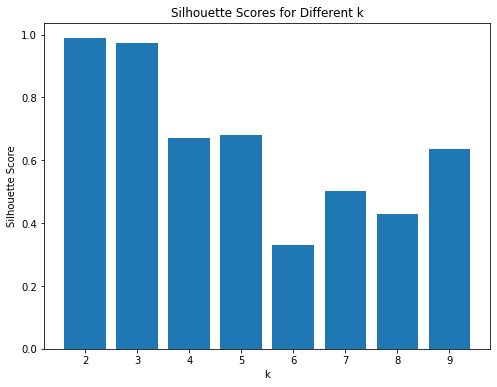

In [0]:
import matplotlib.pyplot as plt

silhouette_scores = [evaluator.evaluate(KMeans(featuresCol='standardized', k=k).fit(scaled_data).transform(scaled_data))
                     for k in range(2, 10)]

# Create a bar plot to compare Silhouette scores for different values of k
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
ax.bar(range(2, 10), silhouette_scores)
ax.set_xlabel('k')
ax.set_ylabel('Silhouette Score')
ax.set_title('Silhouette Scores for Different k')
plt.show()

### Elbow method ###

In [0]:
from pyspark.ml.clustering import KMeansModel

costs = {}# Apply k-means with different values of k
for k in range(2, 10):
# (2:10) - Q: Why this range? How to come up with a good estimate?

    """ 
    A [For K-Means Elbow]: As the number of clusters increase, the average distortion will decrease and each data point will be closer to its cluster centroids. However, the improvements in average distortion will decline as k increases. We test the range from 2 to 10 because
    a minimum of 2 clusters is required for silhouette method to work, and by 10 we are already experiencing diminishing returns.
    """

# DATA FRAME METHOD

    k_means = KMeans(featuresCol='standardized', k=k, seed=123)
    model = k_means.fit(scaled_data)
    costs[k] = model.summary.trainingCost

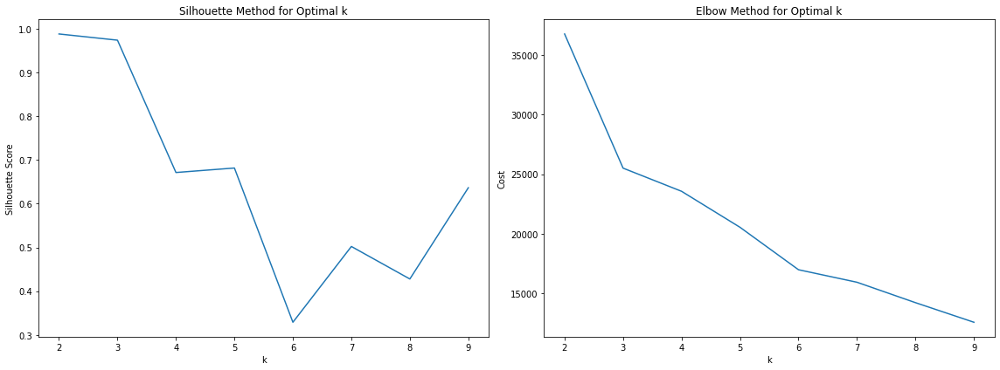

In [0]:
import matplotlib.pyplot as plt

# Combine both plots in a single figure
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot Silhouette Method
ax1.plot(range(2, 10), silhouette_scores)
ax1.set_xlabel('k')
ax1.set_ylabel('Silhouette Score')
ax1.set_title('Silhouette Method for Optimal k')

# Plot Elbow Method
ax2.plot(costs.keys(), costs.values())
ax2.set_xlabel('k')
ax2.set_ylabel('Cost')
ax2.set_title('Elbow Method for Optimal k')

plt.tight_layout()
plt.show()

##### The above graph shows our elbow at 8 which [ideally] corroberates the k value obtained from the silhouette method. #####
##### This will serve as our K value for the next steps #####

#### Implementing KMeans Clustering ####

In [0]:
from pyspark.ml.clustering import KMeans

# With our optimal K value identified, we can proceed with the implementation
k_means = KMeans(featuresCol='scaled_features', k=7, seed=123)
model = k_means.fit(scaled_data1)
predictions = model.transform(scaled_data1)

#result = customer_summary.select('CustID')
#display(result)

In [0]:
display(predictions)

CustID,Unique_Invoice_Orders,Unique_Stockcodes,Total_Stockcode_Orders,Average_Price_Per_Stockcode,Average_Item_per_order,Total_Amount_Ordered,Average_order_Amount,features,scaled_features,prediction
12347,8,126,435,2.59,54.0,9943.32,1242.91,"Map(vectorType -> dense, length -> 7, values -> List(8.0, 126.0, 435.0, 2.59, 54.0, 9943.32, 1242.91))","Map(vectorType -> dense, length -> 7, values -> List(0.5014913608406076, 1.077491696155317, 0.7771779916001048, 0.37009939386059876, 1.8506204595024125, 0.5770238754689853, 2.5657993772049714))",4
12348,5,25,82,4.53,16.0,3816.64,763.33,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 25.0, 82.0, 4.53, 16.0, 3816.64, 763.33))","Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 0.21378803495145177, 0.14650251795680136, 0.6473167004588851, 0.5483319880007148, 0.22148461520598228, 1.5757791301074662))",0
12349,5,139,253,8.34,51.0,6162.09,1232.42,"Map(vectorType -> dense, length -> 7, values -> List(5.0, 139.0, 253.0, 8.34, 51.0, 6162.09, 1232.42))","Map(vectorType -> dense, length -> 7, values -> List(0.3134321005253798, 1.1886614743300719, 0.4520138663789115, 1.191748627334901, 1.7478082117522784, 0.3575941489149177, 2.5441443615828585))",4
12350,1,17,34,3.84,34.0,668.8,668.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 17.0, 34.0, 3.84, 34.0, 668.8, 668.8))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.1453758637669872, 0.06074494646989325, 0.5487187924419689, 1.165205474501519, 0.03881133946344453, 1.3806362676900858))",0
12351,1,21,21,2.36,21.0,300.93,300.93,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 21.0, 21.0, 2.36, 21.0, 300.93, 300.93))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.17958194935921948, 0.0375189375255223, 0.33723342452162663, 0.7196857342509382, 0.017463361819279852, 0.6212243900059473))",0
12352,13,70,208,21.52,16.0,3434.62,264.2,"Map(vectorType -> dense, length -> 7, values -> List(13.0, 70.0, 208.0, 21.52, 16.0, 3434.62, 264.2))","Map(vectorType -> dense, length -> 7, values -> List(0.8149234613659874, 0.598606497864065, 0.3716161431099352, 3.075111565976867, 0.5483319880007148, 0.1993154945393778, 0.545400870101257))",0
12353,2,23,28,3.12,14.0,495.76,247.88,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 23.0, 28.0, 3.12, 14.0, 495.76, 247.88))","Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.1966849921553356, 0.05002525003402973, 0.4458340188590997, 0.47979048950062547, 0.02876960175298634, 0.5117107028035563))",0
12354,1,58,116,4.5,116.0,2158.8,2158.8,"Map(vectorType -> dense, length -> 7, values -> List(1.0, 58.0, 116.0, 4.5, 116.0, 2158.8, 2158.8))","Map(vectorType -> dense, length -> 7, values -> List(0.06268642010507595, 0.49598824108736805, 0.20724746442669462, 0.6430298348929322, 3.9754069130051826, 0.12527798988290084, 4.4565155123943745))",4
12355,2,35,48,3.38,24.0,1407.01,703.5,"Map(vectorType -> dense, length -> 7, values -> List(2.0, 35.0, 48.0, 3.38, 24.0, 1407.01, 703.5))","Map(vectorType -> dense, length -> 7, values -> List(0.1253728402101519, 0.2993032489320325, 0.08575757148690812, 0.4829868537640246, 0.8224979820010723, 0.08165063208501959, 1.4522691601674274))",0
12356,6,104,202,3.16,34.0,9185.11,1530.85,"Map(vectorType -> dense, length -> 7, values -> List(6.0, 104.0, 202.0, 3.16, 34.0, 9185.11, 1530.85))","Map(vectorType -> dense, length -> 7, values -> List(0.3761185206304557, 0.8893582253980393, 0.36089644667407167, 0.45154983961370354, 1.165205474501519, 0.5330239566672833, 3.160207880372859))",4


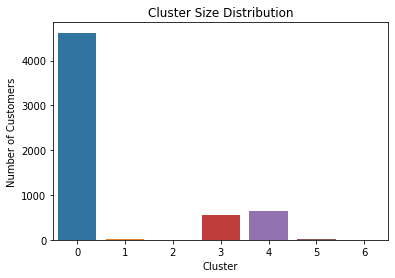

In [0]:
import seaborn as sns

#Cluster size distribution: Finding imbalanced clusters
cluster_counts = predictions.groupBy('prediction').count().orderBy('prediction').toPandas()
sns.barplot(x='prediction', y='count', data=cluster_counts)
plt.xlabel('Cluster')
plt.ylabel('Number of Customers')
plt.title('Cluster Size Distribution')
plt.show()

In [0]:
display(cluster_counts)

prediction,count
0,4622
1,15
2,2
3,543
4,644
5,9
6,4


/databricks/spark/python/pyspark/sql/pandas/conversion.py:92: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

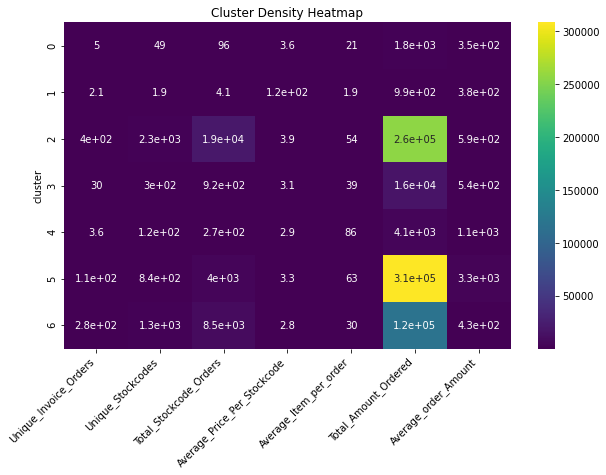

In [0]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pyspark.sql import SparkSession

feature_names = scaled_data.columns

# Get the cluster assignments from the predictions DataFrame
cluster_assignments = np.array(predictions.select('prediction').rdd.flatMap(lambda x: x).collect())

# Convert scaled_data to Pandas DataFrame
scaled_data_pd = scaled_data.toPandas()

# Convert cluster_assignments to a DataFrame
cluster_assignments_pd = pd.DataFrame(cluster_assignments, columns=['cluster'])

# Concatenate the original DataFrame with the cluster assignments DataFrame
df = pd.concat([scaled_data_pd, cluster_assignments_pd], axis=1)

# Calculate the mean of the features for each cluster
cluster_means = df.groupby('cluster').mean()

# Create a heatmap
plt.figure(figsize=(10, 6))
heatmap = sns.heatmap(cluster_means, cmap='viridis', annot=True)
plt.title('Cluster Density Heatmap')

# Slant the x-axis tick labels
heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, ha='right')

plt.show()


In [0]:
print(df.columns)
print(df)

Index(['Unique_Invoice_Orders', 'Unique_Stockcodes', 'Total_Stockcode_Orders',
 'Average_Price_Per_Stockcode', 'Average_Item_per_order',
 'Total_Amount_Ordered', 'Average_order_Amount', 'features',
 'standardized', 'cluster'],
 dtype='object')
 Unique_Invoice_Orders Unique_Stockcodes Total_Stockcode_Orders ... features standardized cluster
0 8 126 435 ... [8.0, 126.0, 435.0, 2.59, 54.0, 9943.32, 1242.91] [0.5014913608406076, 1.077491696155317, 0.7771... 4
1 5 25 82 ... [5.0, 25.0, 82.0, 4.53, 16.0, 3816.64, 763.33] [0.3134321005253798, 0.21378803495145177, 0.14... 0
2 5 139 253 ... [5.0, 139.0, 253.0, 8.34, 51.0, 6162.09, 1232.42] [0.3134321005253798, 1.1886614743300719, 0.452... 4
3 1 17 34 ... [1.0, 17.0, 34.0, 3.84, 34.0, 668.8, 668.8] [0.06268642010507595, 0.1453758637669872, 0.06... 0
4 1 21 21 ... [1.0, 21.0, 21.0, 2.36, 21.0, 300.93, 300.93] [0.06268642010507595, 0.17958194935921948, 0.0... 0
... ... ... ... ... ... ... ...
5834 22 352 1742 ... [22.0, 352.0, 1742.0, 1.69, 79.0, 4831.53, 219... [1.379101242311671, 3.0101355321164407, 3.1122... 3
5835 2 28 29 ... [2.0, 28.0, 29.0, 4.0, 15.0, 436.68, 218.34] [0.1253728402101519, 0.23944259914562596, 0.05... 0
5836 1 12 12 ... [1.0, 12.0, 12.0, 8.35, 12.0, 427.0, 427.0] [0.06268642010507595, 0.10261825677669684, 0.0... 0
5837 3 67 70 ... [3.0, 67.0, 70.0, 4.38, 23.0, 1188.43, 396.14] [0.18805926031522785, 0.5729519336698907, 0.12... 0
5838 8 121 226 ... [8.0, 121.0, 226.0, 2.01, 28.0, 6015.17, 751.9] [0.5014913608406076, 1.0347340891650265, 0.403... 0

[5839 rows x 10 columns]

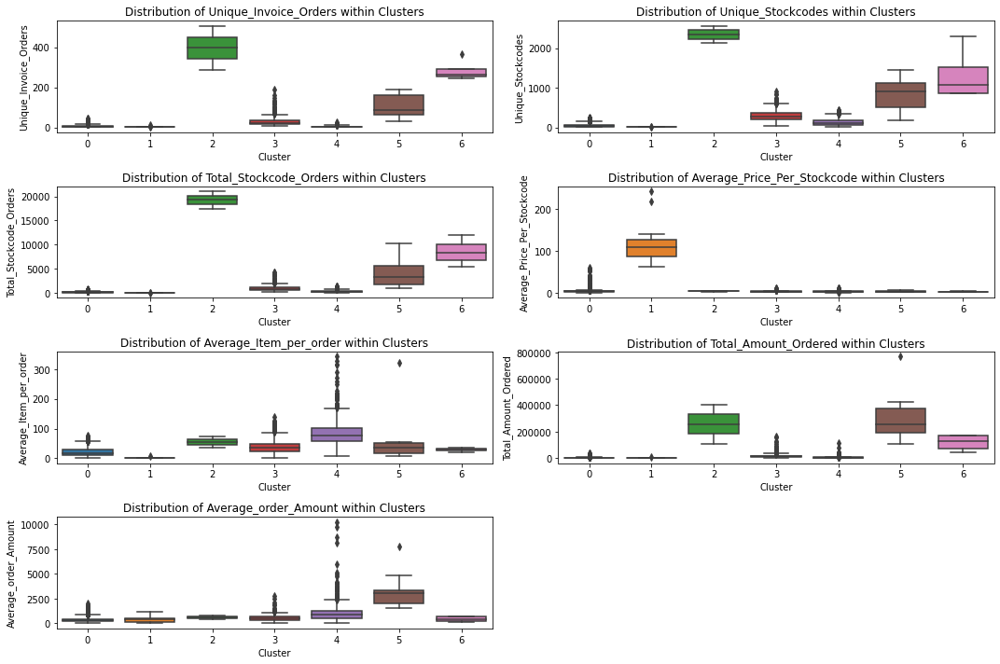

In [0]:
# Define the list of feature names
feature_names = ['Unique_Invoice_Orders', 'Unique_Stockcodes', 'Total_Stockcode_Orders',
                 'Average_Price_Per_Stockcode', 'Average_Item_per_order',
                 'Total_Amount_Ordered', 'Average_order_Amount']

# Create box plots for each feature within each cluster
plt.figure(figsize=(15, 10))
num_features = len(feature_names)
num_rows = (num_features + 1) // 2  # Calculate the number of rows needed for the subplot

for i, feature in enumerate(feature_names):
    plt.subplot(num_rows, 2, i + 1)  # Create the subplot in the current position
    sns.boxplot(x='cluster', y=feature, data=df)
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.title(f'Distribution of {feature} within Clusters')

# Remove any empty subplots
for i in range(num_features, num_rows*2):
    plt.delaxes(plt.subplot(num_rows, 2, i + 1))

plt.tight_layout()  # To ensure the plots do not overlap
plt.show()

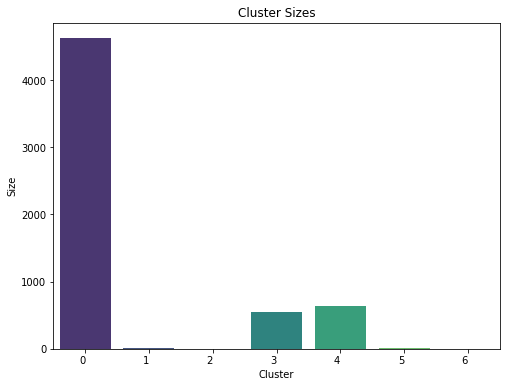

In [0]:

# Calculate the size of each cluster
cluster_sizes = df['cluster'].value_counts().reset_index()
cluster_sizes.columns = ['cluster', 'size']

# Sort the clusters by size in descending order
cluster_sizes = cluster_sizes.sort_values(by='size', ascending=False)

# Create a bar plot
plt.figure(figsize=(8, 6))
barplot = sns.barplot(x='cluster', y='size', data=cluster_sizes, palette='viridis')
plt.title('Cluster Sizes')
plt.xlabel('Cluster')
plt.ylabel('Size')

# Rotate x-axis tick labels
barplot.set_xticklabels(barplot.get_xticklabels(), rotation=0, ha='right')

plt.show()


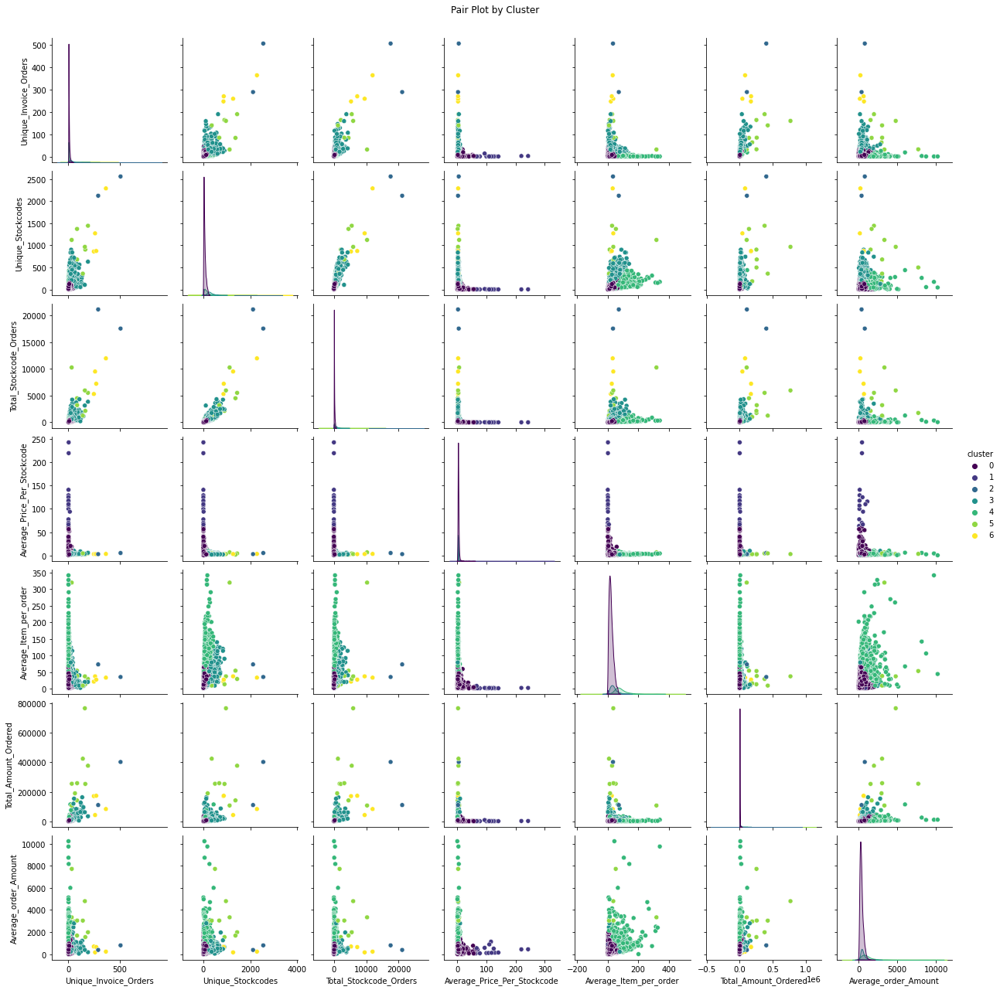

In [0]:
sns.pairplot(df, hue='cluster', vars=feature_names, palette='viridis')
plt.suptitle('Pair Plot by Cluster', y=1.02)
plt.show()


# Each subplot in the pair plot represents a scatter plot showing the relationship between two features. The x-axis and y-axis represent the values of the respective features.
# The points in the scatter plots are colored based on the cluster assignments. This helps identify how different clusters are distributed with respect to each feature pair.
# By examining the scatter plots, you can observe patterns between clusters in various feature combinations.
# Clusters that show distinct patterns or separations in the scatter plots suggest that the corresponding features have a strong influence in differentiating those clusters.









In [0]:
columns_to_count_clusters = ['Unique_Invoice_Orders', 'Unique_Stockcodes', 'Total_Stockcode_Orders',
                             'Average_Price_Per_Stockcode', 'Average_Item_per_order',
                             'Total_Amount_Ordered', 'Average_order_Amount']

# result_df = df.groupby('cluster')[columns_to_count_clusters].nunique()
result_df = df.groupby('cluster')[columns_to_count_clusters].agg(lambda x: x.nunique()).reset_index()
pd.set_option('display.max_columns', 7)
pd.set_option('display.expand_frame_repr', False)


display(result_df)


cluster,Unique_Invoice_Orders,Unique_Stockcodes,Total_Stockcode_Orders,Average_Price_Per_Stockcode,Average_Item_per_order,Total_Amount_Ordered,Average_order_Amount
0,39,215,449,783.0,72.0,4549.0,4408.0
1,3,4,6,15.0,3.0,15.0,15.0
2,2,2,2,2.0,2.0,2.0,2.0
3,84,318,444,270.0,101.0,543.0,540.0
4,19,261,361,306.0,159.0,642.0,643.0
5,9,9,9,9.0,9.0,9.0,9.0
6,4,4,4,4.0,4.0,4.0,4.0
